In [1]:
import lime
import pickle
import pandas as pd
pd.set_option('display.max_colwidth', None)

In [2]:
def load_data(path):
    with open(path, 'rb') as file:
        data = pickle.load(file)
        return data

In [3]:
def get_explained_data(ba):
    explained_data = pd.read_csv(f'Step3/explainability_results/lime/{ba}/explain_data.csv', index_col=0)
    explained_data['name'] = explained_data['name'].apply(lambda x: x.replace('/local_disk/arges/jduret/corpus/', ''))
    return explained_data

# Explicabilité BA2

In [4]:
def init_contributions(df):
    contributions = {}
    columns = list(df.columns[1:-2])
    for column in columns:
        contributions[column] = {0: [], 1: []}
    return contributions

In [5]:
def add_to_contribution(contribution, all_contributions):
    contributions = all_contributions.copy()
    for key1 in contributions:
        for key2, v in contribution:
            if key1 in key2:
                if v < 0:
                    if key2 not in contributions[key1][0]:
                        contributions[key1][0].append(key2)
                else:
                    if key2 not in contributions[key1][1]:
                        contributions[key1][1].append(key2)
    return all_contributions

In [6]:
def filter_contributions(contributions):
    result = {}
    for key, value in contributions.items():
        v_0 = value[0]
        v_1 = value[1]
        n = len(v_0) + len(v_1)
        if n:
            result[key] = value
    return result

## Les données expliquées

In [7]:
explained_data = get_explained_data('BA2')

In [8]:
explained_data

,name,F0semitoneFrom27.5Hz_sma3nz_amean,F0semitoneFrom27.5Hz_sma3nz_stddevNorm,F0semitoneFrom27.5Hz_sma3nz_percentile20.0,F0semitoneFrom27.5Hz_sma3nz_percentile50.0,F0semitoneFrom27.5Hz_sma3nz_percentile80.0,F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2,F0semitoneFrom27.5Hz_sma3nz_meanRisingSlope,F0semitoneFrom27.5Hz_sma3nz_stddevRisingSlope,F0semitoneFrom27.5Hz_sma3nz_meanFallingSlope,...,spectralFluxUV_sma3nz_amean,loudnessPeaksPerSec,VoicedSegmentsPerSec,MeanVoicedSegmentLengthSec,StddevVoicedSegmentLengthSec,MeanUnvoicedSegmentLength,StddevUnvoicedSegmentLength,equivalentSoundLevel_dBp,y_true,y_pred
59647,voxceleb2/wav/id04183/CZDD6SxK_M8/00008.wav,0.664801,-0.694950,0.808209,0.734907,0.546412,-0.478072,-0.659560,-0.623369,-0.212651,...,4.192214,1.884486,1.374851,-0.490126,0.112659,-0.655550,-0.779134,2.107834,0,0
8776,voxceleb2/wav/id00501/UFO5jqAc7Hs/00113.wav,1.157957,-0.354345,1.067966,1.055860,1.167465,0.412685,-0.648087,-0.719990,-0.250759,...,-0.231269,1.458645,0.388951,0.030397,-0.131939,-0.496286,-0.559339,0.052594,0,0
18147,voxceleb2/wav/id00938/0p00w2DkaKU/00004.wav,1.268495,4.343296,-2.075276,2.344078,2.301882,9.914468,4.871076,4.455114,3.768176,...,1.513842,0.743332,2.535547,-1.607716,-1.176139,-0.116009,-0.247001,0.626206,0,1
243099,voxceleb2/wav/id06539/dyS3z1TB2fU/00051.wav,-0.748492,-0.148740,-0.744658,-0.658618,-0.625658,0.153933,-0.541138,-0.194645,-0.410122,...,-0.896117,0.416753,-0.599804,0.307282,-0.432937,0.158508,-0.087469,-2.240601,1,1
140858,voxceleb2/wav/id09197/cvUTjpLVOwI/00129.wav,0.266734,-0.162509,0.365450,0.216141,-0.022706,-0.848718,-0.172149,-0.255623,-0.604724,...,-0.504128,0.344691,-0.624085,0.719556,0.144385,-0.165506,0.802031,0.071794,0,0
73454,voxceleb2/wav/id05104/hX7Z6UqTnZQ/00307.wav,1.715862,-0.219110,1.624286,1.948193,1.640702,0.311333,-0.311281,-0.299941,1.181316,...,1.193182,0.058215,2.825600,-0.941004,-0.667902,-0.805422,-1.307498,1.086329,0,0
3220,voxceleb2/wav/id00266/HPPS0sb7-no/00157.wav,-0.304779,1.082617,-0.943929,0.212666,0.088020,2.261041,-0.396016,-0.526195,-0.047297,...,-0.209445,-0.285362,-0.293650,-1.103157,-0.881544,0.670628,1.411751,-0.414189,0,1
183217,voxceleb2/wav/id02730/0XP6sTDq7uE/00001.wav,1.854107,-0.590377,1.754481,1.721946,1.798114,0.397016,-0.606901,-0.688556,2.940955,...,-0.430427,0.014061,-0.442299,0.183272,0.865341,-0.018105,0.619982,-0.220201,1,0
181035,voxceleb2/wav/id02573/tlKvsiAYpg0/00432.wav,-1.368779,1.595917,-1.168149,-1.052868,-1.101981,-0.041079,2.062607,1.084101,0.340217,...,-0.421407,0.652829,1.814772,-1.043055,-0.561006,-0.350864,-0.165596,-1.014684,1,1
100626,voxceleb2/wav/id06702/ytLjTWP-UTo/00493.wav,0.002643,0.171689,-0.186386,-0.139863,0.288973,1.083260,-0.670167,-0.789088,-0.163577,...,2.090156,1.569272,0.176863,0.359047,0.122580,-0.578832,-1.177357,1.589160,0,0


In [9]:
contributions = init_contributions(explained_data)

## Le fichier audio: voxceleb2/wav/id04183/CZDD6SxK_M8/00008.wav

In [10]:
import numpy as np

In [11]:
path = 'Step3/explainability_results/lime/BA2/59647/explanation.pkl'
explanation = load_data(path)

In [12]:
def specific_data(df, pos, explanation):
    row = df.loc[pos, ['name', 'y_true', 'y_pred']]
    df_row = pd.DataFrame(row).transpose()
    return df_row

In [13]:
specific_data(explained_data, 59647, explanation)

,name,y_true,y_pred
59647,voxceleb2/wav/id04183/CZDD6SxK_M8/00008.wav,0,0


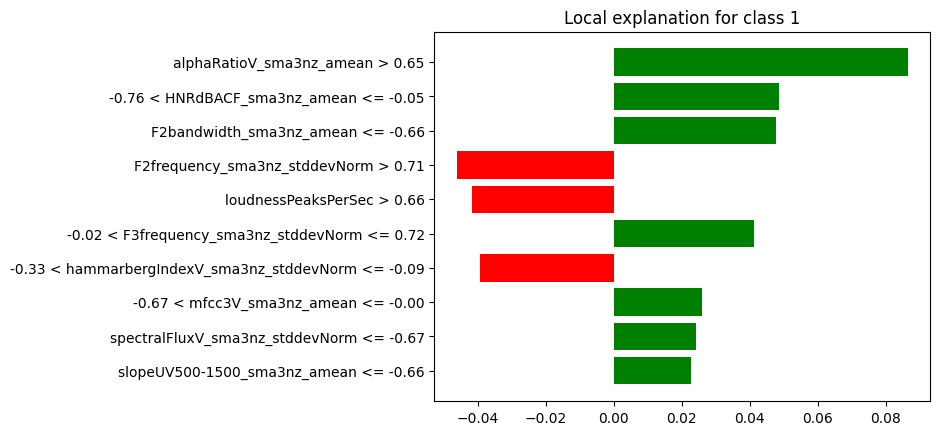

In [14]:
out = explanation.as_pyplot_figure()

In [15]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])

In [16]:
df_exp

,feature,value
0,alphaRatioV_sma3nz_amean > 0.65,0.086558
1,-0.76 < HNRdBACF_sma3nz_amean <= -0.05,0.048758
2,F2bandwidth_sma3nz_amean <= -0.66,0.047664
3,F2frequency_sma3nz_stddevNorm > 0.71,-0.046151
4,loudnessPeaksPerSec > 0.66,-0.041617
5,-0.02 < F3frequency_sma3nz_stddevNorm <= 0.72,0.041314
6,-0.33 < hammarbergIndexV_sma3nz_stddevNorm <= -0.09,-0.039470
7,-0.67 < mfcc3V_sma3nz_amean <= -0.00,0.025927
8,spectralFluxV_sma3nz_stddevNorm <= -0.67,0.024141
9,slopeUV500-1500_sma3nz_amean <= -0.66,0.022609


In [17]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [18]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier: voxceleb2/wav/id00501/UFO5jqAc7Hs/00113.wav

In [19]:
path = 'Step3/explainability_results/lime/BA2/8776/explanation.pkl'
explanation = load_data(path)

In [20]:
specific_data(explained_data, 8776, explanation)

,name,y_true,y_pred
8776,voxceleb2/wav/id00501/UFO5jqAc7Hs/00113.wav,0,0


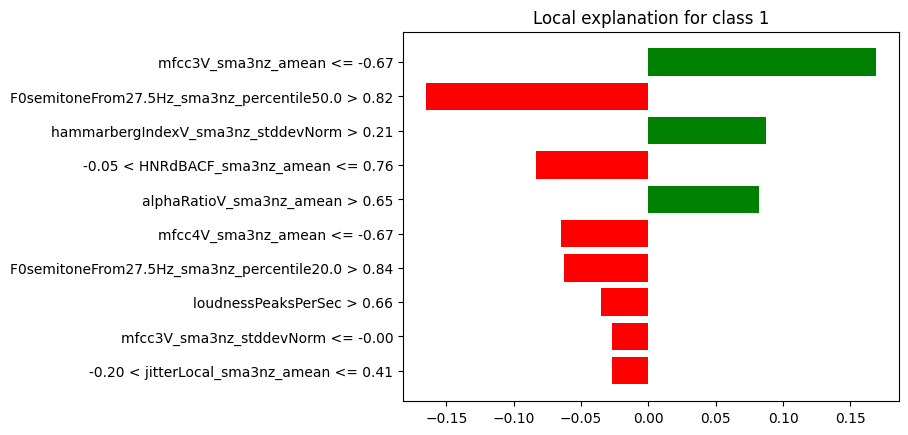

In [21]:
out = explanation.as_pyplot_figure()

In [22]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,mfcc3V_sma3nz_amean <= -0.67,0.169302
1,F0semitoneFrom27.5Hz_sma3nz_percentile50.0 > 0.82,-0.165562
2,hammarbergIndexV_sma3nz_stddevNorm > 0.21,0.087590
3,-0.05 < HNRdBACF_sma3nz_amean <= 0.76,-0.083203
4,alphaRatioV_sma3nz_amean > 0.65,0.082101
5,mfcc4V_sma3nz_amean <= -0.67,-0.065303
6,F0semitoneFrom27.5Hz_sma3nz_percentile20.0 > 0.84,-0.062797
7,loudnessPeaksPerSec > 0.66,-0.035162
8,mfcc3V_sma3nz_stddevNorm <= -0.00,-0.027235
9,-0.20 < jitterLocal_sma3nz_amean <= 0.41,-0.026779


In [23]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [24]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier: voxceleb2/wav/id00938/0p00w2DkaKU/00004.wav

In [25]:
path = 'Step3/explainability_results/lime/BA2/18147/explanation.pkl'
explanation = load_data(path)

In [26]:
specific_data(explained_data, 18147, explanation)

,name,y_true,y_pred
18147,voxceleb2/wav/id00938/0p00w2DkaKU/00004.wav,0,1


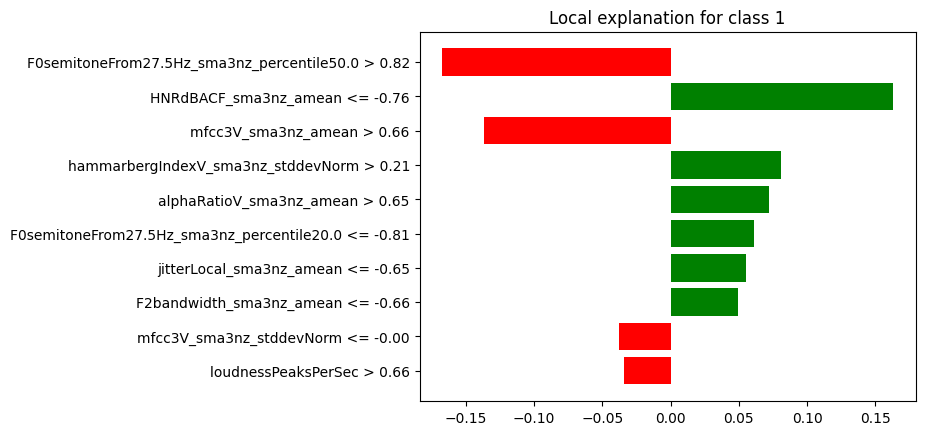

In [27]:
out = explanation.as_pyplot_figure()

In [28]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,F0semitoneFrom27.5Hz_sma3nz_percentile50.0 > 0.82,-0.167309
1,HNRdBACF_sma3nz_amean <= -0.76,0.162934
2,mfcc3V_sma3nz_amean > 0.66,-0.136981
3,hammarbergIndexV_sma3nz_stddevNorm > 0.21,0.080989
4,alphaRatioV_sma3nz_amean > 0.65,0.071718
5,F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= -0.81,0.060845
6,jitterLocal_sma3nz_amean <= -0.65,0.055146
7,F2bandwidth_sma3nz_amean <= -0.66,0.049404
8,mfcc3V_sma3nz_stddevNorm <= -0.00,-0.037522
9,loudnessPeaksPerSec > 0.66,-0.034185


In [29]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [30]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier: voxceleb2/wav/id06539/dyS3z1TB2fU/00051.wav

In [31]:
path = 'Step3/explainability_results/lime/BA2/243099/explanation.pkl'
explanation = load_data(path)

In [32]:
specific_data(explained_data, 243099, explanation)

,name,y_true,y_pred
243099,voxceleb2/wav/id06539/dyS3z1TB2fU/00051.wav,1,1


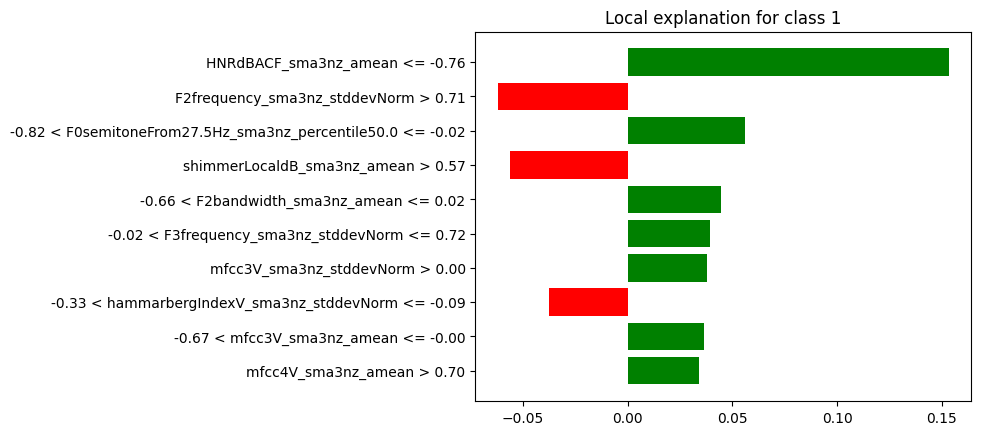

In [33]:
out = explanation.as_pyplot_figure()

In [34]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,HNRdBACF_sma3nz_amean <= -0.76,0.153294
1,F2frequency_sma3nz_stddevNorm > 0.71,-0.061887
2,-0.82 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.02,0.056158
3,shimmerLocaldB_sma3nz_amean > 0.57,-0.055945
4,-0.66 < F2bandwidth_sma3nz_amean <= 0.02,0.044602
5,-0.02 < F3frequency_sma3nz_stddevNorm <= 0.72,0.039531
6,mfcc3V_sma3nz_stddevNorm > 0.00,0.037794
7,-0.33 < hammarbergIndexV_sma3nz_stddevNorm <= -0.09,-0.037290
8,-0.67 < mfcc3V_sma3nz_amean <= -0.00,0.036328
9,mfcc4V_sma3nz_amean > 0.70,0.034292


In [35]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [36]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier: voxceleb2/wav/id09197/cvUTjpLVOwI/00129.wav

In [37]:
path = 'Step3/explainability_results/lime/BA2/140858/explanation.pkl'
explanation = load_data(path)

In [38]:
specific_data(explained_data, 140858, explanation)

,name,y_true,y_pred
140858,voxceleb2/wav/id09197/cvUTjpLVOwI/00129.wav,0,0


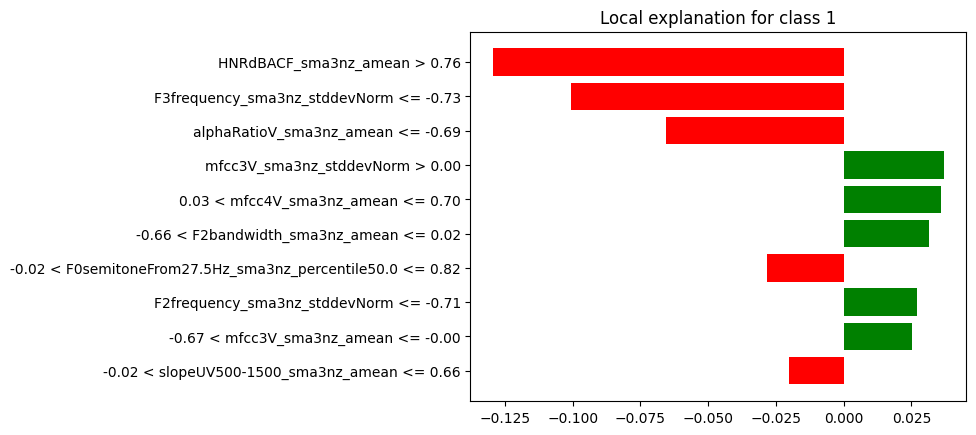

In [39]:
out = explanation.as_pyplot_figure()

In [40]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,HNRdBACF_sma3nz_amean > 0.76,-0.129436
1,F3frequency_sma3nz_stddevNorm <= -0.73,-0.100634
2,alphaRatioV_sma3nz_amean <= -0.69,-0.065728
3,mfcc3V_sma3nz_stddevNorm > 0.00,0.037027
4,0.03 < mfcc4V_sma3nz_amean <= 0.70,0.035815
5,-0.66 < F2bandwidth_sma3nz_amean <= 0.02,0.031415
6,-0.02 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= 0.82,-0.028374
7,F2frequency_sma3nz_stddevNorm <= -0.71,0.027226
8,-0.67 < mfcc3V_sma3nz_amean <= -0.00,0.025237
9,-0.02 < slopeUV500-1500_sma3nz_amean <= 0.66,-0.020235


In [41]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [42]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier: voxceleb2/wav/id05104/hX7Z6UqTnZQ/00307.wav	

In [43]:
path = 'Step3/explainability_results/lime/BA2/73454/explanation.pkl'
explanation = load_data(path)

In [44]:
specific_data(explained_data, 73454, explanation)

,name,y_true,y_pred
73454,voxceleb2/wav/id05104/hX7Z6UqTnZQ/00307.wav,0,0


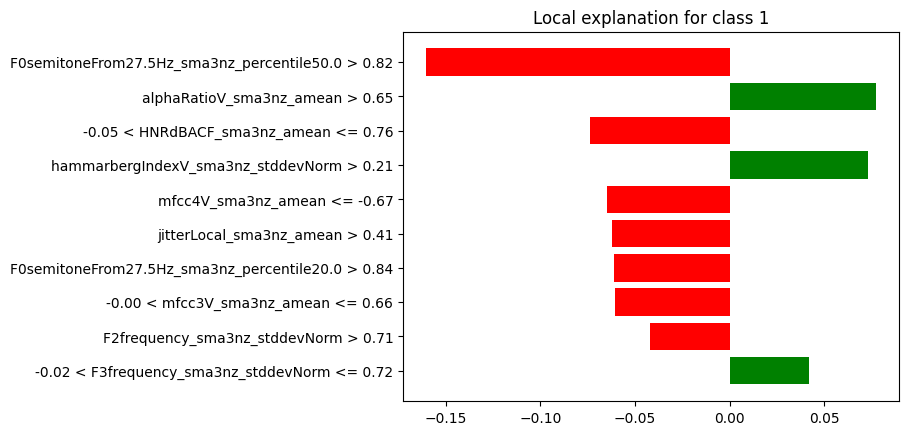

In [45]:
out = explanation.as_pyplot_figure()

In [46]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,F0semitoneFrom27.5Hz_sma3nz_percentile50.0 > 0.82,-0.160778
1,alphaRatioV_sma3nz_amean > 0.65,0.077571
2,-0.05 < HNRdBACF_sma3nz_amean <= 0.76,-0.073603
3,hammarbergIndexV_sma3nz_stddevNorm > 0.21,0.073209
4,mfcc4V_sma3nz_amean <= -0.67,-0.064892
5,jitterLocal_sma3nz_amean > 0.41,-0.062177
6,F0semitoneFrom27.5Hz_sma3nz_percentile20.0 > 0.84,-0.061031
7,-0.00 < mfcc3V_sma3nz_amean <= 0.66,-0.060633
8,F2frequency_sma3nz_stddevNorm > 0.71,-0.041862
9,-0.02 < F3frequency_sma3nz_stddevNorm <= 0.72,0.041847


In [47]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [48]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier: voxceleb2/wav/id00266/HPPS0sb7-no/00157.wav

In [49]:
path = 'Step3/explainability_results/lime/BA2/3220/explanation.pkl'
explanation = load_data(path)

In [50]:
specific_data(explained_data, 3220, explanation)

,name,y_true,y_pred
3220,voxceleb2/wav/id00266/HPPS0sb7-no/00157.wav,0,1


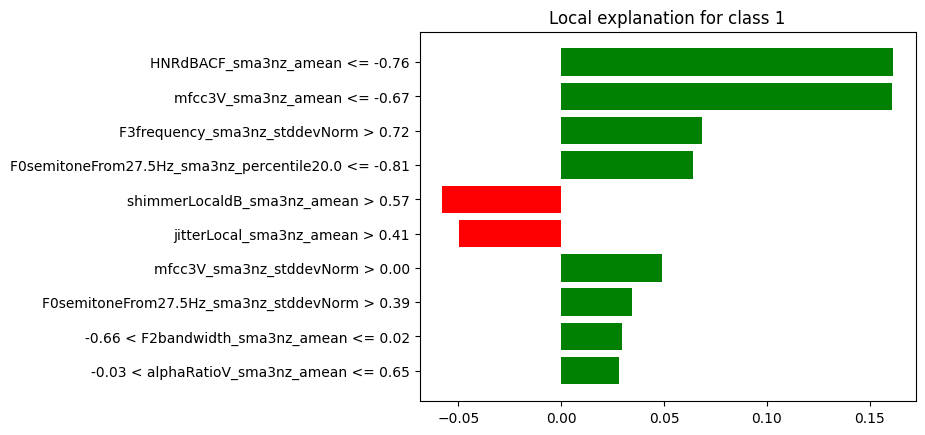

In [51]:
out = explanation.as_pyplot_figure()

In [52]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,HNRdBACF_sma3nz_amean <= -0.76,0.161456
1,mfcc3V_sma3nz_amean <= -0.67,0.161099
2,F3frequency_sma3nz_stddevNorm > 0.72,0.068484
3,F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= -0.81,0.064265
4,shimmerLocaldB_sma3nz_amean > 0.57,-0.057925
5,jitterLocal_sma3nz_amean > 0.41,-0.049918
6,mfcc3V_sma3nz_stddevNorm > 0.00,0.049235
7,F0semitoneFrom27.5Hz_sma3nz_stddevNorm > 0.39,0.034596
8,-0.66 < F2bandwidth_sma3nz_amean <= 0.02,0.029705
9,-0.03 < alphaRatioV_sma3nz_amean <= 0.65,0.028160


In [53]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [54]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier: voxceleb2/wav/id02730/0XP6sTDq7uE/00001.wav	

In [55]:
path = 'Step3/explainability_results/lime/BA2/183217/explanation.pkl'
explanation = load_data(path)

In [56]:
specific_data(explained_data, 183217, explanation)

,name,y_true,y_pred
183217,voxceleb2/wav/id02730/0XP6sTDq7uE/00001.wav,1,0


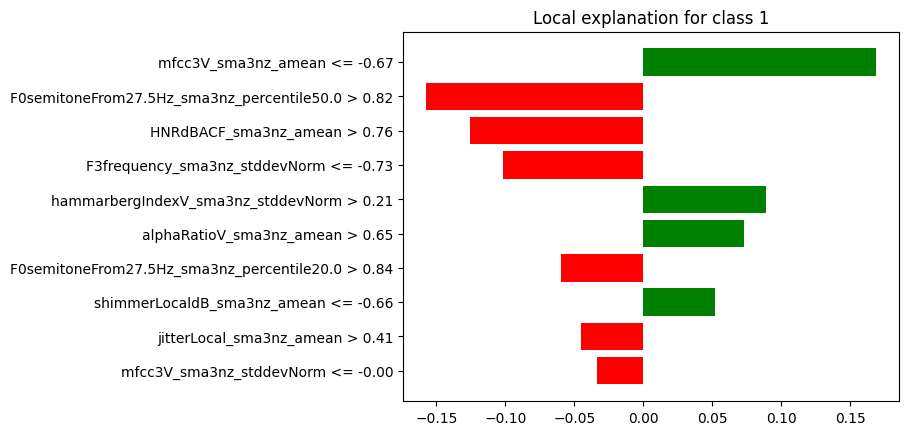

In [57]:
out = explanation.as_pyplot_figure()

In [58]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,mfcc3V_sma3nz_amean <= -0.67,0.169123
1,F0semitoneFrom27.5Hz_sma3nz_percentile50.0 > 0.82,-0.157829
2,HNRdBACF_sma3nz_amean > 0.76,-0.125841
3,F3frequency_sma3nz_stddevNorm <= -0.73,-0.101487
4,hammarbergIndexV_sma3nz_stddevNorm > 0.21,0.088802
5,alphaRatioV_sma3nz_amean > 0.65,0.073281
6,F0semitoneFrom27.5Hz_sma3nz_percentile20.0 > 0.84,-0.059924
7,shimmerLocaldB_sma3nz_amean <= -0.66,0.052329
8,jitterLocal_sma3nz_amean > 0.41,-0.045157
9,mfcc3V_sma3nz_stddevNorm <= -0.00,-0.033467


In [59]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [60]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier: voxceleb2/wav/id02573/tlKvsiAYpg0/00432.wav

In [61]:
path = 'Step3/explainability_results/lime/BA2/181035/explanation.pkl'
explanation = load_data(path)

In [62]:
specific_data(explained_data, 181035, explanation)

,name,y_true,y_pred
181035,voxceleb2/wav/id02573/tlKvsiAYpg0/00432.wav,1,1


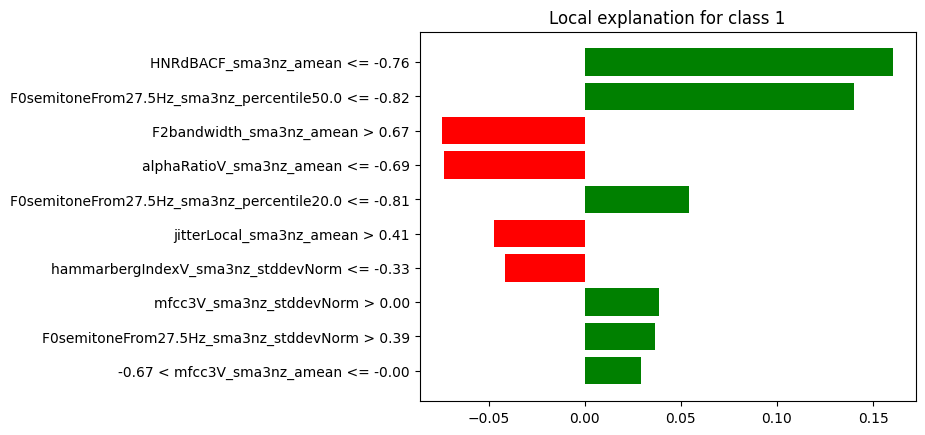

In [63]:
out = explanation.as_pyplot_figure()

In [64]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,HNRdBACF_sma3nz_amean <= -0.76,0.160396
1,F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.82,0.140168
2,F2bandwidth_sma3nz_amean > 0.67,-0.074130
3,alphaRatioV_sma3nz_amean <= -0.69,-0.072942
4,F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= -0.81,0.054452
5,jitterLocal_sma3nz_amean > 0.41,-0.047127
6,hammarbergIndexV_sma3nz_stddevNorm <= -0.33,-0.041267
7,mfcc3V_sma3nz_stddevNorm > 0.00,0.038446
8,F0semitoneFrom27.5Hz_sma3nz_stddevNorm > 0.39,0.036621
9,-0.67 < mfcc3V_sma3nz_amean <= -0.00,0.029353


In [65]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [66]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier: voxceleb2/wav/id06702/ytLjTWP-UTo/00493.wav

In [67]:
path = 'Step3/explainability_results/lime/BA2/100626/explanation.pkl'
explanation = load_data(path)

In [68]:
specific_data(explained_data, 100626, explanation)

,name,y_true,y_pred
100626,voxceleb2/wav/id06702/ytLjTWP-UTo/00493.wav,0,0


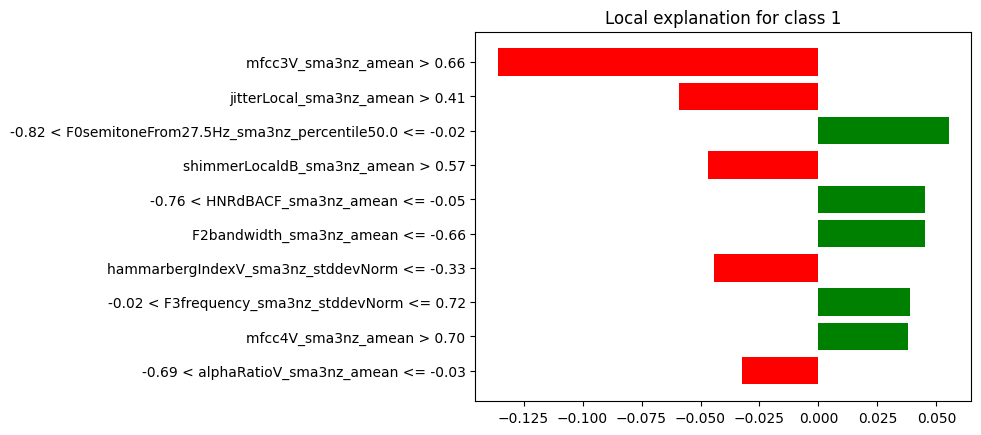

In [69]:
out = explanation.as_pyplot_figure()

In [70]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,mfcc3V_sma3nz_amean > 0.66,-0.135870
1,jitterLocal_sma3nz_amean > 0.41,-0.058965
2,-0.82 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.02,0.055232
3,shimmerLocaldB_sma3nz_amean > 0.57,-0.046635
4,-0.76 < HNRdBACF_sma3nz_amean <= -0.05,0.045351
5,F2bandwidth_sma3nz_amean <= -0.66,0.044973
6,hammarbergIndexV_sma3nz_stddevNorm <= -0.33,-0.044213
7,-0.02 < F3frequency_sma3nz_stddevNorm <= 0.72,0.038683
8,mfcc4V_sma3nz_amean > 0.70,0.037888
9,-0.69 < alphaRatioV_sma3nz_amean <= -0.03,-0.032226


In [71]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [72]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

In [73]:
contributions = filter_contributions(contributions)

In [74]:
def display_specific_attribute(contributions, key):
    key_contributions = contributions[key]
    v_0 = {0: key_contributions[0]}
    v_1 = {1: key_contributions[1]}
    df_0 = pd.DataFrame(v_0)
    df_1 = pd.DataFrame(v_1)
    return df_0, df_1

In [75]:
features = list(contributions.keys())

In [76]:
features

['F0semitoneFrom27.5Hz_sma3nz_stddevNorm',
 'F0semitoneFrom27.5Hz_sma3nz_percentile20.0',
 'F0semitoneFrom27.5Hz_sma3nz_percentile50.0',
 'jitterLocal_sma3nz_amean',
 'shimmerLocaldB_sma3nz_amean',
 'HNRdBACF_sma3nz_amean',
 'F2frequency_sma3nz_stddevNorm',
 'F2bandwidth_sma3nz_amean',
 'F3frequency_sma3nz_stddevNorm',
 'alphaRatioV_sma3nz_amean',
 'hammarbergIndexV_sma3nz_stddevNorm',
 'spectralFluxV_sma3nz_stddevNorm',
 'mfcc3V_sma3nz_amean',
 'mfcc3V_sma3nz_stddevNorm',
 'mfcc4V_sma3nz_amean',
 'slopeUV500-1500_sma3nz_amean',
 'loudnessPeaksPerSec']

In [77]:
len(features)

17

In [78]:
df_0, df_1 = display_specific_attribute(contributions, 'F0semitoneFrom27.5Hz_sma3nz_stddevNorm')

In [79]:
df_0

,0


In [80]:
df_1

,1
0,F0semitoneFrom27.5Hz_sma3nz_stddevNorm > 0.39


In [81]:
df_0, df_1 = display_specific_attribute(contributions, 'F0semitoneFrom27.5Hz_sma3nz_percentile20.0')

In [82]:
df_0

,0
0,F0semitoneFrom27.5Hz_sma3nz_percentile20.0 > 0.84


In [83]:
df_1

,1
0,F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= -0.81


In [84]:
df_0, df_1 = display_specific_attribute(contributions, 'F0semitoneFrom27.5Hz_sma3nz_percentile50.0')

In [85]:
df_0

,0
0,F0semitoneFrom27.5Hz_sma3nz_percentile50.0 > 0.82
1,-0.02 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= 0.82


In [86]:
df_1

,1
0,-0.82 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.02
1,F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.82


In [87]:
df_0, df_1 = display_specific_attribute(contributions, 'jitterLocal_sma3nz_amean')

In [88]:
df_0

,0
0,-0.20 < jitterLocal_sma3nz_amean <= 0.41
1,jitterLocal_sma3nz_amean > 0.41


In [89]:
df_1

,1
0,jitterLocal_sma3nz_amean <= -0.65


In [90]:
df_0, df_1 = display_specific_attribute(contributions, 'shimmerLocaldB_sma3nz_amean')

In [91]:
df_0

,0
0,shimmerLocaldB_sma3nz_amean > 0.57


In [92]:
df_1

,1
0,shimmerLocaldB_sma3nz_amean <= -0.66


In [93]:
df_0, df_1 = display_specific_attribute(contributions, 'HNRdBACF_sma3nz_amean')

In [94]:
df_0

,0
0,-0.05 < HNRdBACF_sma3nz_amean <= 0.76
1,HNRdBACF_sma3nz_amean > 0.76


In [95]:
df_1

,1
0,-0.76 < HNRdBACF_sma3nz_amean <= -0.05
1,HNRdBACF_sma3nz_amean <= -0.76


In [96]:
df_0, df_1 = display_specific_attribute(contributions, 'F2frequency_sma3nz_stddevNorm')

In [97]:
df_0

,0
0,F2frequency_sma3nz_stddevNorm > 0.71


In [98]:
df_1

,1
0,F2frequency_sma3nz_stddevNorm <= -0.71


In [99]:
df_0, df_1 = display_specific_attribute(contributions, 'F2bandwidth_sma3nz_amean')

In [100]:
df_0

,0
0,F2bandwidth_sma3nz_amean > 0.67


In [101]:
df_1

,1
0,F2bandwidth_sma3nz_amean <= -0.66
1,-0.66 < F2bandwidth_sma3nz_amean <= 0.02


In [102]:
df_0, df_1 = display_specific_attribute(contributions, 'F3frequency_sma3nz_stddevNorm')

In [103]:
df_0

,0
0,F3frequency_sma3nz_stddevNorm <= -0.73


In [104]:
df_1

,1
0,-0.02 < F3frequency_sma3nz_stddevNorm <= 0.72
1,F3frequency_sma3nz_stddevNorm > 0.72


In [105]:
df_0, df_1 = display_specific_attribute(contributions, 'alphaRatioV_sma3nz_amean')

In [106]:
df_0

,0
0,alphaRatioV_sma3nz_amean <= -0.69
1,-0.69 < alphaRatioV_sma3nz_amean <= -0.03


In [107]:
df_1

,1
0,alphaRatioV_sma3nz_amean > 0.65
1,-0.03 < alphaRatioV_sma3nz_amean <= 0.65


In [108]:
df_0, df_1 = display_specific_attribute(contributions, 'hammarbergIndexV_sma3nz_stddevNorm')

In [109]:
df_0

,0
0,-0.33 < hammarbergIndexV_sma3nz_stddevNorm <= -0.09
1,hammarbergIndexV_sma3nz_stddevNorm <= -0.33


In [110]:
df_1

,1
0,hammarbergIndexV_sma3nz_stddevNorm > 0.21


In [111]:
df_0, df_1 = display_specific_attribute(contributions, 'spectralFluxV_sma3nz_stddevNorm')

In [112]:
df_0

,0


In [113]:
df_1

,1
0,spectralFluxV_sma3nz_stddevNorm <= -0.67


In [114]:
df_0, df_1 = display_specific_attribute(contributions, 'mfcc3V_sma3nz_amean')

In [115]:
df_0

,0
0,mfcc3V_sma3nz_amean > 0.66
1,-0.00 < mfcc3V_sma3nz_amean <= 0.66


In [116]:
df_1

,1
0,-0.67 < mfcc3V_sma3nz_amean <= -0.00
1,mfcc3V_sma3nz_amean <= -0.67


In [117]:
df_0, df_1 = display_specific_attribute(contributions, 'mfcc3V_sma3nz_stddevNorm')

In [118]:
df_0

,0
0,mfcc3V_sma3nz_stddevNorm <= -0.00


In [119]:
df_1

,1
0,mfcc3V_sma3nz_stddevNorm > 0.00


In [120]:
df_0, df_1 = display_specific_attribute(contributions, 'mfcc4V_sma3nz_amean')

In [121]:
df_0

,0
0,mfcc4V_sma3nz_amean <= -0.67


In [122]:
df_1

,1
0,mfcc4V_sma3nz_amean > 0.70
1,0.03 < mfcc4V_sma3nz_amean <= 0.70


In [123]:
df_0, df_1 = display_specific_attribute(contributions, 'slopeUV500-1500_sma3nz_amean')

In [124]:
df_0

,0
0,-0.02 < slopeUV500-1500_sma3nz_amean <= 0.66


In [125]:
df_1

,1
0,slopeUV500-1500_sma3nz_amean <= -0.66


In [126]:
df_0, df_1 = display_specific_attribute(contributions, 'loudnessPeaksPerSec')

In [127]:
df_0

,0
0,loudnessPeaksPerSec > 0.66


In [128]:
df_1

,1


# Explicabilité BA3

## Les données expliquées

In [129]:
explained_data = get_explained_data('BA3')
explained_data

,name,F0semitoneFrom27.5Hz_sma3nz_amean,F0semitoneFrom27.5Hz_sma3nz_stddevNorm,F0semitoneFrom27.5Hz_sma3nz_percentile20.0,F0semitoneFrom27.5Hz_sma3nz_percentile50.0,F0semitoneFrom27.5Hz_sma3nz_percentile80.0,F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2,F0semitoneFrom27.5Hz_sma3nz_meanRisingSlope,F0semitoneFrom27.5Hz_sma3nz_stddevRisingSlope,F0semitoneFrom27.5Hz_sma3nz_meanFallingSlope,...,spectralFluxUV_sma3nz_amean,loudnessPeaksPerSec,VoicedSegmentsPerSec,MeanVoicedSegmentLengthSec,StddevVoicedSegmentLengthSec,MeanUnvoicedSegmentLength,StddevUnvoicedSegmentLength,equivalentSoundLevel_dBp,y_true,y_pred
17527,voxceleb2/wav/id05545/G7hoTM-UvBg/00059.wav,-0.515866,-1.175357,-0.277912,-0.460833,-0.671300,-0.978068,-0.281539,-0.298424,-0.550374,...,-0.151299,-0.424518,-0.596127,0.954361,0.999871,-0.434331,-0.078893,-0.047664,0,0
40523,voxceleb2/wav/id04254/l0SexptUjmQ/00301.wav,0.198149,1.507729,-0.378488,0.105493,0.653916,2.318700,0.124463,0.164273,0.067258,...,-0.756891,1.441571,0.592266,-0.193708,-0.359722,-0.449284,-0.439505,-1.446820,1,1
32165,voxceleb2/wav/id01225/W_aaJLVW9mI/00288.wav,0.604583,0.011739,0.660558,0.464189,0.437711,-0.370846,1.567405,1.940157,-0.275981,...,-0.879780,-0.466944,-0.751431,0.308454,-0.092559,0.265694,0.668868,-1.730970,1,1
46895,voxceleb2/wav/id06262/xao25DtdG9k/00485.wav,-0.466745,0.318597,-0.320838,-0.450257,-0.566025,-0.642665,-0.554776,-0.714314,1.564371,...,-0.747060,-0.574263,0.093645,-0.857306,-0.973947,0.850702,0.716727,-1.074640,1,0
10955,voxceleb2/wav/id03529/MNziT38SwfM/00016.wav,0.133726,-1.118555,0.403047,0.193044,-0.105181,-1.092900,-0.605016,-0.434800,-0.446410,...,-0.253376,-0.477805,-1.637243,2.212615,1.247585,-0.041682,-0.451188,0.648823,0,1
13998,voxceleb2/wav/id04319/fZ8e_H3_lO4/00135.wav,-1.225846,-1.216530,-0.937307,-1.132077,-1.352668,-1.176910,-0.538926,-0.333271,-0.515327,...,-0.202011,0.744684,0.629849,-0.357536,-0.114255,-0.326559,-0.441267,-0.057505,0,0
22108,voxceleb2/wav/id06968/9f-Kv8bO_ro/00020.wav,-0.465977,-1.118615,-0.251131,-0.439728,-0.578746,-0.818948,-0.216308,-0.272711,-0.503731,...,0.645206,1.186825,0.146756,-0.190689,-0.230620,-0.223591,0.333508,0.970360,0,0
7564,voxceleb2/wav/id02869/sShtW83QCIM/00060.wav,-0.031140,-0.613213,0.016301,0.040160,-0.058672,-0.170887,-0.607021,-0.554760,-0.489609,...,-0.879913,-0.497612,0.089607,0.508989,-0.038576,-0.629844,-1.339563,-1.481088,0,0
7107,voxceleb2/wav/id02260/oomx4E4Q_c4/00438.wav,-0.322583,2.042023,-0.771372,-0.521260,0.215451,2.124590,2.406082,3.886593,0.377554,...,-0.361974,0.496409,0.232540,-0.710788,-0.027045,0.243880,-0.041107,-0.182873,0,0
50658,voxceleb2/wav/id07463/UvbJeLCzwgk/00106.wav,-0.558688,-0.786580,-0.401973,-0.541171,-0.665945,-0.704568,-0.723967,-0.543586,-0.450894,...,-0.694242,0.316648,-2.469155,3.986829,2.674116,0.471438,0.474978,-0.125481,1,1


In [130]:
contributions = init_contributions(explained_data)

## Le fichier voxceleb2/wav/id05545/G7hoTM-UvBg/00059.wav

In [131]:
path = 'Step3/explainability_results/lime/BA3/17527/explanation.pkl'
explanation = load_data(path)

In [132]:
specific_data(explained_data, 17527, explanation)

,name,y_true,y_pred
17527,voxceleb2/wav/id05545/G7hoTM-UvBg/00059.wav,0,0


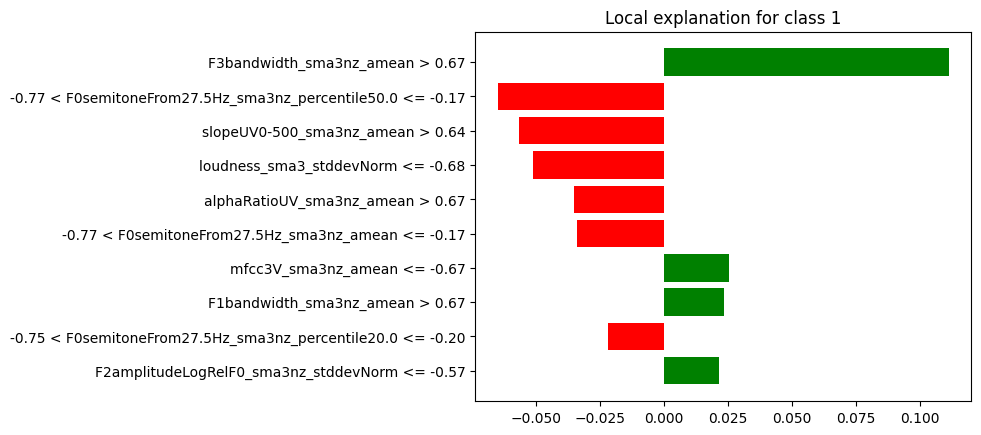

In [133]:
out = explanation.as_pyplot_figure()

In [134]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,F3bandwidth_sma3nz_amean > 0.67,0.111167
1,-0.77 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.17,-0.064682
2,slopeUV0-500_sma3nz_amean > 0.64,-0.056309
3,loudness_sma3_stddevNorm <= -0.68,-0.051183
4,alphaRatioUV_sma3nz_amean > 0.67,-0.034850
5,-0.77 < F0semitoneFrom27.5Hz_sma3nz_amean <= -0.17,-0.033943
6,mfcc3V_sma3nz_amean <= -0.67,0.025541
7,F1bandwidth_sma3nz_amean > 0.67,0.023465
8,-0.75 < F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= -0.20,-0.021812
9,F2amplitudeLogRelF0_sma3nz_stddevNorm <= -0.57,0.021368


In [135]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [136]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier voxceleb2/wav/id04254/l0SexptUjmQ/00301.wav	

In [137]:
path = 'Step3/explainability_results/lime/BA3/40523/explanation.pkl'
explanation = load_data(path)

In [138]:
specific_data(explained_data, 40523, explanation)

,name,y_true,y_pred
40523,voxceleb2/wav/id04254/l0SexptUjmQ/00301.wav,1,1


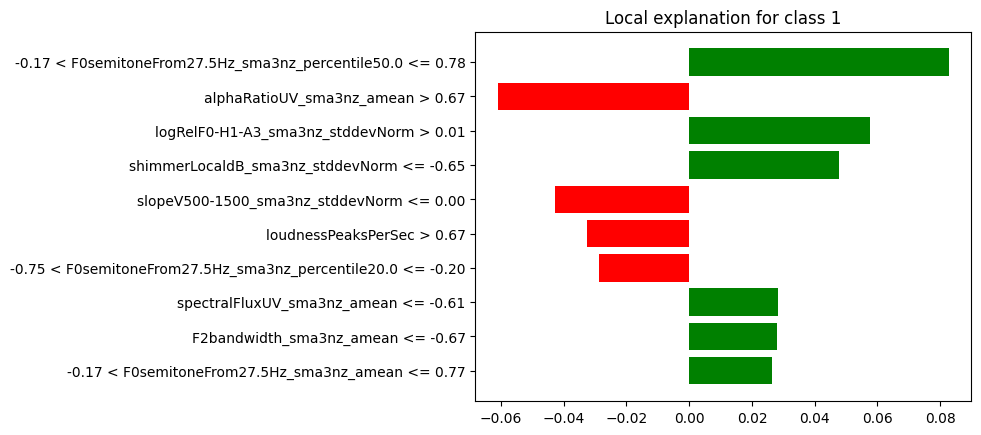

In [139]:
out = explanation.as_pyplot_figure()

In [140]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,-0.17 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= 0.78,0.082695
1,alphaRatioUV_sma3nz_amean > 0.67,-0.061031
2,logRelF0-H1-A3_sma3nz_stddevNorm > 0.01,0.057742
3,shimmerLocaldB_sma3nz_stddevNorm <= -0.65,0.047578
4,slopeV500-1500_sma3nz_stddevNorm <= 0.00,-0.042870
5,loudnessPeaksPerSec > 0.67,-0.032608
6,-0.75 < F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= -0.20,-0.028877
7,spectralFluxUV_sma3nz_amean <= -0.61,0.028292
8,F2bandwidth_sma3nz_amean <= -0.67,0.028027
9,-0.17 < F0semitoneFrom27.5Hz_sma3nz_amean <= 0.77,0.026488


In [141]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [142]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier voxceleb2/wav/id01225/W_aaJLVW9mI/00288.wav

In [143]:
path = 'Step3/explainability_results/lime/BA3/32165/explanation.pkl'
explanation = load_data(path)

In [144]:
specific_data(explained_data, 32165, explanation)

,name,y_true,y_pred
32165,voxceleb2/wav/id01225/W_aaJLVW9mI/00288.wav,1,1


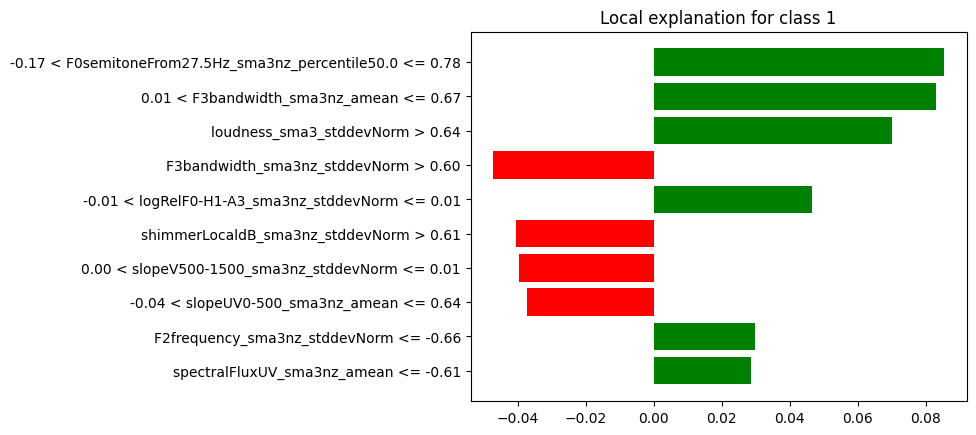

In [145]:
out = explanation.as_pyplot_figure()

In [146]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,-0.17 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= 0.78,0.085367
1,0.01 < F3bandwidth_sma3nz_amean <= 0.67,0.082915
2,loudness_sma3_stddevNorm > 0.64,0.070208
3,F3bandwidth_sma3nz_stddevNorm > 0.60,-0.047186
4,-0.01 < logRelF0-H1-A3_sma3nz_stddevNorm <= 0.01,0.046648
5,shimmerLocaldB_sma3nz_stddevNorm > 0.61,-0.040350
6,0.00 < slopeV500-1500_sma3nz_stddevNorm <= 0.01,-0.039506
7,-0.04 < slopeUV0-500_sma3nz_amean <= 0.64,-0.037231
8,F2frequency_sma3nz_stddevNorm <= -0.66,0.029740
9,spectralFluxUV_sma3nz_amean <= -0.61,0.028668


In [147]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [148]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier voxceleb2/wav/id06262/xao25DtdG9k/00485.wav

In [149]:
path = 'Step3/explainability_results/lime/BA3/46895/explanation.pkl'
explanation = load_data(path)

In [150]:
specific_data(explained_data, 46895, explanation)

,name,y_true,y_pred
46895,voxceleb2/wav/id06262/xao25DtdG9k/00485.wav,1,0


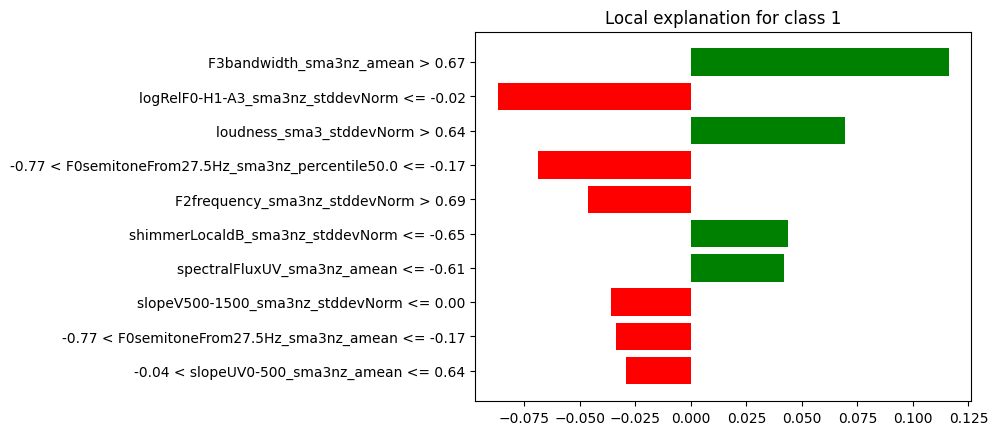

In [151]:
out = explanation.as_pyplot_figure()

In [152]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,F3bandwidth_sma3nz_amean > 0.67,0.116182
1,logRelF0-H1-A3_sma3nz_stddevNorm <= -0.02,-0.086923
2,loudness_sma3_stddevNorm > 0.64,0.069354
3,-0.77 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.17,-0.069054
4,F2frequency_sma3nz_stddevNorm > 0.69,-0.046483
5,shimmerLocaldB_sma3nz_stddevNorm <= -0.65,0.043727
6,spectralFluxUV_sma3nz_amean <= -0.61,0.042066
7,slopeV500-1500_sma3nz_stddevNorm <= 0.00,-0.035828
8,-0.77 < F0semitoneFrom27.5Hz_sma3nz_amean <= -0.17,-0.033889
9,-0.04 < slopeUV0-500_sma3nz_amean <= 0.64,-0.029337


In [153]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [154]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier voxceleb2/wav/id03529/MNziT38SwfM/00016.wav

In [155]:
path = 'Step3/explainability_results/lime/BA3/10955/explanation.pkl'
explanation = load_data(path)

In [156]:
specific_data(explained_data, 10955, explanation)

,name,y_true,y_pred
10955,voxceleb2/wav/id03529/MNziT38SwfM/00016.wav,0,1


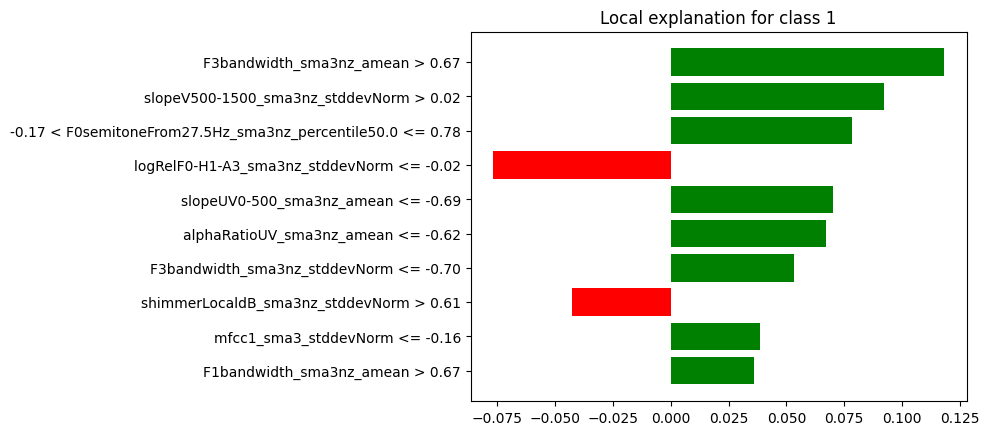

In [157]:
out = explanation.as_pyplot_figure()

In [158]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,F3bandwidth_sma3nz_amean > 0.67,0.118097
1,slopeV500-1500_sma3nz_stddevNorm > 0.02,0.092182
2,-0.17 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= 0.78,0.078537
3,logRelF0-H1-A3_sma3nz_stddevNorm <= -0.02,-0.076664
4,slopeUV0-500_sma3nz_amean <= -0.69,0.070249
5,alphaRatioUV_sma3nz_amean <= -0.62,0.067102
6,F3bandwidth_sma3nz_stddevNorm <= -0.70,0.053470
7,shimmerLocaldB_sma3nz_stddevNorm > 0.61,-0.042662
8,mfcc1_sma3_stddevNorm <= -0.16,0.038646
9,F1bandwidth_sma3nz_amean > 0.67,0.036026


In [159]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [160]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier voxceleb2/wav/id04319/fZ8e_H3_lO4/00135.wav

In [161]:
path = 'Step3/explainability_results/lime/BA3/13998/explanation.pkl'
explanation = load_data(path)

In [162]:
specific_data(explained_data, 13998, explanation)

,name,y_true,y_pred
13998,voxceleb2/wav/id04319/fZ8e_H3_lO4/00135.wav,0,0


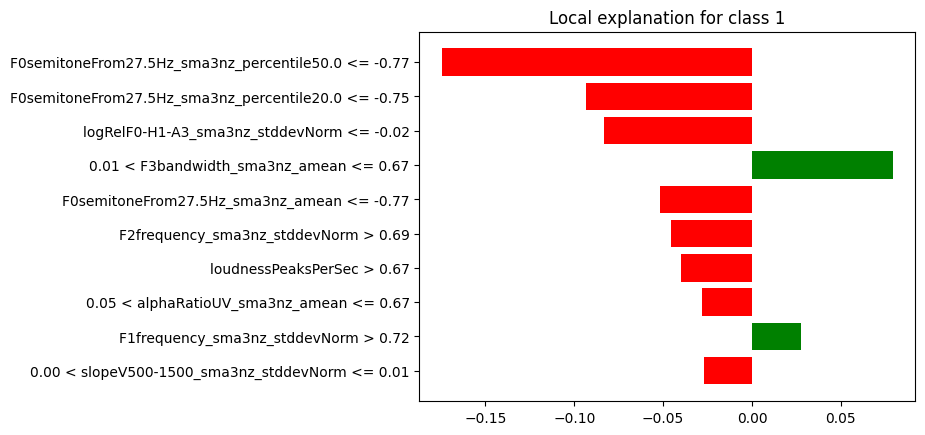

In [163]:
out = explanation.as_pyplot_figure()

In [164]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.77,-0.174515
1,F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= -0.75,-0.093288
2,logRelF0-H1-A3_sma3nz_stddevNorm <= -0.02,-0.083457
3,0.01 < F3bandwidth_sma3nz_amean <= 0.67,0.079265
4,F0semitoneFrom27.5Hz_sma3nz_amean <= -0.77,-0.052010
5,F2frequency_sma3nz_stddevNorm > 0.69,-0.045850
6,loudnessPeaksPerSec > 0.67,-0.039672
7,0.05 < alphaRatioUV_sma3nz_amean <= 0.67,-0.028013
8,F1frequency_sma3nz_stddevNorm > 0.72,0.027352
9,0.00 < slopeV500-1500_sma3nz_stddevNorm <= 0.01,-0.027257


In [165]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [166]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier voxceleb2/wav/id06968/9f-Kv8bO_ro/00020.wav

In [167]:
path = 'Step3/explainability_results/lime/BA3/22108/explanation.pkl'
explanation = load_data(path)

In [168]:
specific_data(explained_data, 22108, explanation)

,name,y_true,y_pred
22108,voxceleb2/wav/id06968/9f-Kv8bO_ro/00020.wav,0,0


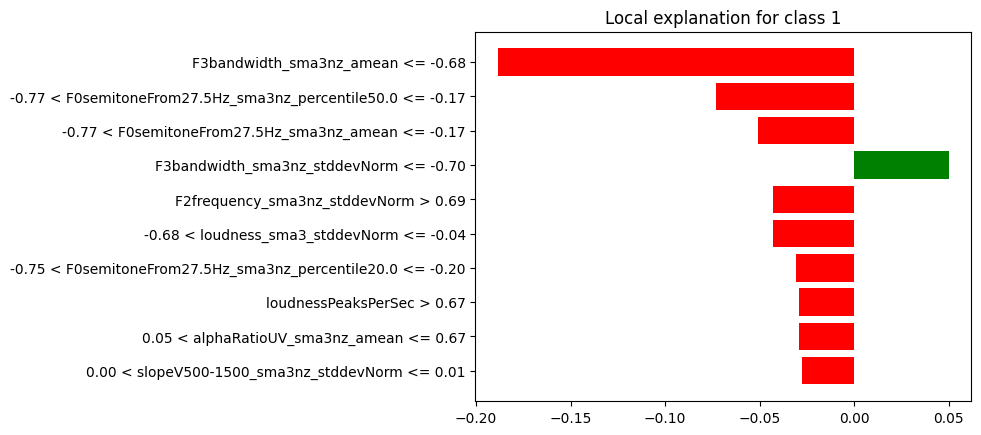

In [169]:
out = explanation.as_pyplot_figure()

In [170]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,F3bandwidth_sma3nz_amean <= -0.68,-0.188455
1,-0.77 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.17,-0.073209
2,-0.77 < F0semitoneFrom27.5Hz_sma3nz_amean <= -0.17,-0.050817
3,F3bandwidth_sma3nz_stddevNorm <= -0.70,0.050098
4,F2frequency_sma3nz_stddevNorm > 0.69,-0.042833
5,-0.68 < loudness_sma3_stddevNorm <= -0.04,-0.042686
6,-0.75 < F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= -0.20,-0.030524
7,loudnessPeaksPerSec > 0.67,-0.029172
8,0.05 < alphaRatioUV_sma3nz_amean <= 0.67,-0.029147
9,0.00 < slopeV500-1500_sma3nz_stddevNorm <= 0.01,-0.027535


In [171]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [172]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier voxceleb2/wav/id02869/sShtW83QCIM/00060.wav

In [173]:
path = 'Step3/explainability_results/lime/BA3/7564/explanation.pkl'
explanation = load_data(path)

In [174]:
specific_data(explained_data, 7564, explanation)

,name,y_true,y_pred
7564,voxceleb2/wav/id02869/sShtW83QCIM/00060.wav,0,0


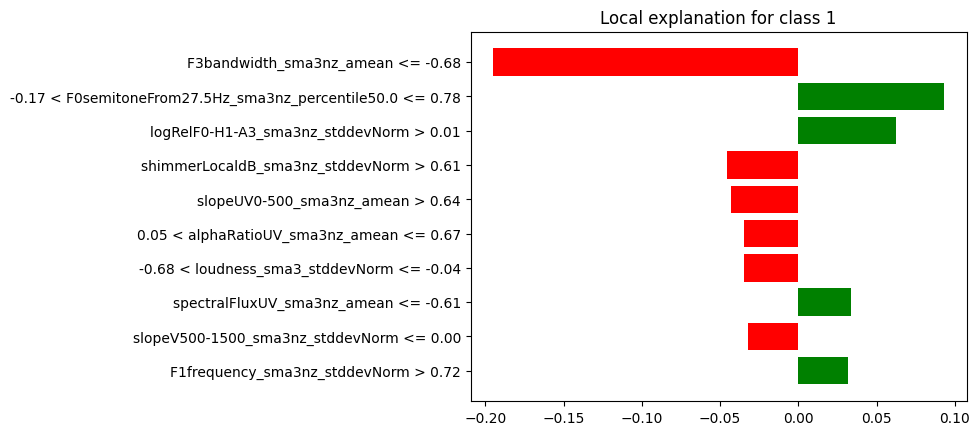

In [175]:
out = explanation.as_pyplot_figure()

In [176]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,F3bandwidth_sma3nz_amean <= -0.68,-0.194950
1,-0.17 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= 0.78,0.093049
2,logRelF0-H1-A3_sma3nz_stddevNorm > 0.01,0.062099
3,shimmerLocaldB_sma3nz_stddevNorm > 0.61,-0.045695
4,slopeUV0-500_sma3nz_amean > 0.64,-0.042944
5,0.05 < alphaRatioUV_sma3nz_amean <= 0.67,-0.034850
6,-0.68 < loudness_sma3_stddevNorm <= -0.04,-0.034775
7,spectralFluxUV_sma3nz_amean <= -0.61,0.033635
8,slopeV500-1500_sma3nz_stddevNorm <= 0.00,-0.032141
9,F1frequency_sma3nz_stddevNorm > 0.72,0.031807


In [177]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [178]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier voxceleb2/wav/id02260/oomx4E4Q_c4/00438.wav

In [179]:
path = 'Step3/explainability_results/lime/BA3/7107/explanation.pkl'
explanation = load_data(path)

In [180]:
specific_data(explained_data, 7107, explanation)

,name,y_true,y_pred
7107,voxceleb2/wav/id02260/oomx4E4Q_c4/00438.wav,0,0


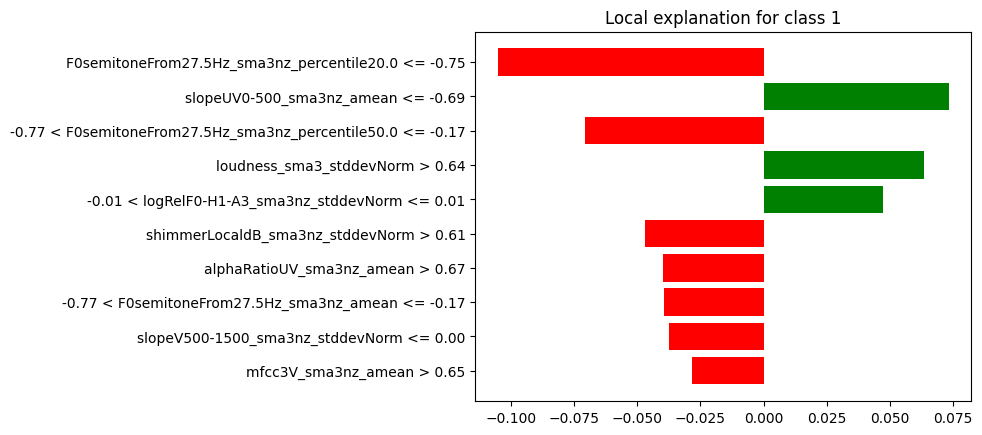

In [181]:
out = explanation.as_pyplot_figure()

In [182]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= -0.75,-0.105083
1,slopeUV0-500_sma3nz_amean <= -0.69,0.073231
2,-0.77 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.17,-0.070482
3,loudness_sma3_stddevNorm > 0.64,0.063540
4,-0.01 < logRelF0-H1-A3_sma3nz_stddevNorm <= 0.01,0.047025
5,shimmerLocaldB_sma3nz_stddevNorm > 0.61,-0.046835
6,alphaRatioUV_sma3nz_amean > 0.67,-0.039927
7,-0.77 < F0semitoneFrom27.5Hz_sma3nz_amean <= -0.17,-0.039241
8,slopeV500-1500_sma3nz_stddevNorm <= 0.00,-0.037600
9,mfcc3V_sma3nz_amean > 0.65,-0.028347


In [183]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [184]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

## Le fichier voxceleb2/wav/id07463/UvbJeLCzwgk/00106.wav	

In [185]:
path = 'Step3/explainability_results/lime/BA3/50658/explanation.pkl'
explanation = load_data(path)

In [186]:
specific_data(explained_data, 50658, explanation)

,name,y_true,y_pred
50658,voxceleb2/wav/id07463/UvbJeLCzwgk/00106.wav,1,1


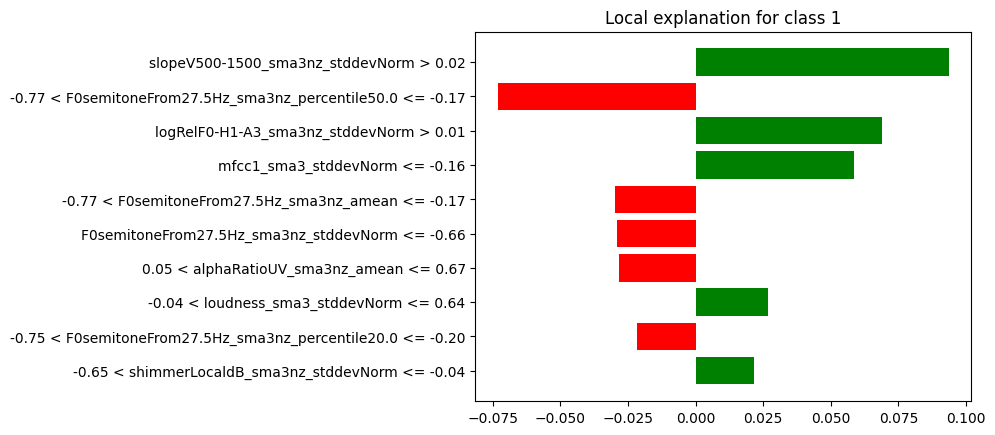

In [187]:
out = explanation.as_pyplot_figure()

In [188]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,slopeV500-1500_sma3nz_stddevNorm > 0.02,0.093641
1,-0.77 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.17,-0.073138
2,logRelF0-H1-A3_sma3nz_stddevNorm > 0.01,0.068960
3,mfcc1_sma3_stddevNorm <= -0.16,0.058431
4,-0.77 < F0semitoneFrom27.5Hz_sma3nz_amean <= -0.17,-0.029959
5,F0semitoneFrom27.5Hz_sma3nz_stddevNorm <= -0.66,-0.029092
6,0.05 < alphaRatioUV_sma3nz_amean <= 0.67,-0.028186
7,-0.04 < loudness_sma3_stddevNorm <= 0.64,0.026611
8,-0.75 < F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= -0.20,-0.021670
9,-0.65 < shimmerLocaldB_sma3nz_stddevNorm <= -0.04,0.021581


In [189]:
contributions = add_to_contribution(explanation.as_list(), contributions)

In [190]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

In [191]:
contributions = filter_contributions(contributions)

In [192]:
features = list(contributions.keys())

In [193]:
features

['F0semitoneFrom27.5Hz_sma3nz_amean',
 'F0semitoneFrom27.5Hz_sma3nz_stddevNorm',
 'F0semitoneFrom27.5Hz_sma3nz_percentile20.0',
 'F0semitoneFrom27.5Hz_sma3nz_percentile50.0',
 'loudness_sma3_stddevNorm',
 'mfcc1_sma3_stddevNorm',
 'shimmerLocaldB_sma3nz_stddevNorm',
 'logRelF0-H1-A3_sma3nz_stddevNorm',
 'F1frequency_sma3nz_stddevNorm',
 'F1bandwidth_sma3nz_amean',
 'F2frequency_sma3nz_stddevNorm',
 'F2bandwidth_sma3nz_amean',
 'F2amplitudeLogRelF0_sma3nz_stddevNorm',
 'F3bandwidth_sma3nz_amean',
 'F3bandwidth_sma3nz_stddevNorm',
 'slopeV500-1500_sma3nz_stddevNorm',
 'mfcc3V_sma3nz_amean',
 'alphaRatioUV_sma3nz_amean',
 'slopeUV0-500_sma3nz_amean',
 'spectralFluxUV_sma3nz_amean',
 'loudnessPeaksPerSec']

In [194]:
len(features)

21

In [195]:
df_0, df_1 = display_specific_attribute(contributions, 'F0semitoneFrom27.5Hz_sma3nz_amean')

In [196]:
df_0

,0
0,-0.77 < F0semitoneFrom27.5Hz_sma3nz_amean <= -0.17
1,F0semitoneFrom27.5Hz_sma3nz_amean <= -0.77


In [197]:
df_1

,1
0,-0.17 < F0semitoneFrom27.5Hz_sma3nz_amean <= 0.77


In [198]:
df_0, df_1 = display_specific_attribute(contributions, 'F0semitoneFrom27.5Hz_sma3nz_stddevNorm')

In [199]:
df_0

,0
0,F0semitoneFrom27.5Hz_sma3nz_stddevNorm <= -0.66


In [200]:
df_1

,1


In [201]:
df_0, df_1 = display_specific_attribute(contributions, 'F0semitoneFrom27.5Hz_sma3nz_percentile20.0')

In [202]:
df_0

,0
0,-0.75 < F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= -0.20
1,F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= -0.75


In [203]:
df_1

,1


In [204]:
df_0, df_1 = display_specific_attribute(contributions, 'F0semitoneFrom27.5Hz_sma3nz_percentile50.0')

In [205]:
df_0

,0
0,-0.77 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.17
1,F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.77


In [206]:
df_1

,1
0,-0.17 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= 0.78


In [207]:
df_0, df_1 = display_specific_attribute(contributions, 'loudness_sma3_stddevNorm')

In [208]:
df_0

,0
0,loudness_sma3_stddevNorm <= -0.68
1,-0.68 < loudness_sma3_stddevNorm <= -0.04


In [209]:
df_1

,1
0,loudness_sma3_stddevNorm > 0.64
1,-0.04 < loudness_sma3_stddevNorm <= 0.64


In [210]:
df_0, df_1 = display_specific_attribute(contributions, 'mfcc1_sma3_stddevNorm')

In [211]:
df_0

,0


In [212]:
df_1

,1
0,mfcc1_sma3_stddevNorm <= -0.16


In [213]:
df_0, df_1 = display_specific_attribute(contributions, 'shimmerLocaldB_sma3nz_stddevNorm')

In [214]:
df_0

,0
0,shimmerLocaldB_sma3nz_stddevNorm > 0.61


In [215]:
df_1

,1
0,shimmerLocaldB_sma3nz_stddevNorm <= -0.65
1,-0.65 < shimmerLocaldB_sma3nz_stddevNorm <= -0.04


In [216]:
df_0, df_1 = display_specific_attribute(contributions, 'logRelF0-H1-A3_sma3nz_stddevNorm')

In [217]:
df_0

,0
0,logRelF0-H1-A3_sma3nz_stddevNorm <= -0.02


In [218]:
df_1

,1
0,logRelF0-H1-A3_sma3nz_stddevNorm > 0.01
1,-0.01 < logRelF0-H1-A3_sma3nz_stddevNorm <= 0.01


In [219]:
df_0, df_1 = display_specific_attribute(contributions, 'F1frequency_sma3nz_stddevNorm')

In [220]:
df_0

,0


In [221]:
df_1

,1
0,F1frequency_sma3nz_stddevNorm > 0.72


In [222]:
df_0, df_1 = display_specific_attribute(contributions, 'F1bandwidth_sma3nz_amean')

In [223]:
df_0

,0


In [224]:
df_1

,1
0,F1bandwidth_sma3nz_amean > 0.67


In [225]:
df_0, df_1 = display_specific_attribute(contributions, 'F2frequency_sma3nz_stddevNorm')

In [226]:
df_0

,0
0,F2frequency_sma3nz_stddevNorm > 0.69


In [227]:
df_1

,1
0,F2frequency_sma3nz_stddevNorm <= -0.66


In [228]:
df_0, df_1 = display_specific_attribute(contributions, 'F2bandwidth_sma3nz_amean')

In [229]:
df_0

,0


In [230]:
df_1

,1
0,F2bandwidth_sma3nz_amean <= -0.67


In [231]:
df_0, df_1 = display_specific_attribute(contributions, 'F2amplitudeLogRelF0_sma3nz_stddevNorm')

In [232]:
df_0

,0


In [233]:
df_1

,1
0,F2amplitudeLogRelF0_sma3nz_stddevNorm <= -0.57


In [234]:
df_0, df_1 = display_specific_attribute(contributions, 'F3bandwidth_sma3nz_amean')

In [235]:
df_0

,0
0,F3bandwidth_sma3nz_amean <= -0.68


In [236]:
df_1

,1
0,F3bandwidth_sma3nz_amean > 0.67
1,0.01 < F3bandwidth_sma3nz_amean <= 0.67


In [237]:
df_0, df_1 = display_specific_attribute(contributions, 'F3bandwidth_sma3nz_stddevNorm')

In [238]:
df_0

,0
0,F3bandwidth_sma3nz_stddevNorm > 0.60


In [239]:
df_1

,1
0,F3bandwidth_sma3nz_stddevNorm <= -0.70


In [240]:
df_0, df_1 = display_specific_attribute(contributions, 'slopeV500-1500_sma3nz_stddevNorm')

In [241]:
df_0

,0
0,slopeV500-1500_sma3nz_stddevNorm <= 0.00
1,0.00 < slopeV500-1500_sma3nz_stddevNorm <= 0.01


In [242]:
df_1

,1
0,slopeV500-1500_sma3nz_stddevNorm > 0.02


In [243]:
df_0, df_1 = display_specific_attribute(contributions, 'mfcc3V_sma3nz_amean')

In [244]:
df_0

,0
0,mfcc3V_sma3nz_amean > 0.65


In [245]:
df_1

,1
0,mfcc3V_sma3nz_amean <= -0.67


In [246]:
df_0, df_1 = display_specific_attribute(contributions, 'alphaRatioUV_sma3nz_amean')

In [247]:
df_0

,0
0,alphaRatioUV_sma3nz_amean > 0.67
1,0.05 < alphaRatioUV_sma3nz_amean <= 0.67


In [248]:
df_1

,1
0,alphaRatioUV_sma3nz_amean <= -0.62


In [249]:
df_0, df_1 = display_specific_attribute(contributions, 'slopeUV0-500_sma3nz_amean')

In [250]:
df_0

,0
0,slopeUV0-500_sma3nz_amean > 0.64
1,-0.04 < slopeUV0-500_sma3nz_amean <= 0.64


In [251]:
df_1

,1
0,slopeUV0-500_sma3nz_amean <= -0.69


In [252]:
df_0, df_1 = display_specific_attribute(contributions, 'spectralFluxUV_sma3nz_amean')

In [253]:
df_0

,0


In [254]:
df_1

,1
0,spectralFluxUV_sma3nz_amean <= -0.61


In [256]:
df_0, df_1 = display_specific_attribute(contributions, 'loudnessPeaksPerSec')

In [257]:
df_0

,0
0,loudnessPeaksPerSec > 0.67


In [258]:
df_1

,1
